<a href="https://colab.research.google.com/github/AbouCamara/IA-FORCE-N/blob/main/Getting_Started.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 1. Installer les dépendances et configurer

In [1]:
!pip install tensorflow tensorflow-gpu opencv-python matplotlib

  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  Preparing metadata (setup.py) ... error
error: metadata-generation-failed

× Encountered error while generating package metadata.
╰─> See above for output.

note: This is an issue with the package mentioned above, not pip.
hint: See above for details.


In [2]:
!pip list

Package                            Version
---------------------------------- ------------------
absl-py                            1.4.0
accelerate                         1.3.0
aiohappyeyeballs                   2.4.6
aiohttp                            3.11.13
aiosignal                          1.3.2
alabaster                          1.0.0
albucore                           0.0.23
albumentations                     2.0.5
ale-py                             0.10.2
altair                             5.5.0
annotated-types                    0.7.0
anyio                              3.7.1
argon2-cffi                        23.1.0
argon2-cffi-bindings               21.2.0
array_record                       0.6.0
arviz                              0.20.0
astropy                            7.0.1
astropy-iers-data                  0.2025.3.3.0.34.45
astunparse                         1.6.3
atpublic                           4.1.0
attrs                              25.1.0
audioread            

In [3]:
import tensorflow as tf
import os

In [4]:
# Évitez les erreurs OOM en définissant la croissance de la consommation de mémoire du GPU
gpus = tf.config.experimental.list_physical_devices('GPU')
for gpu in gpus:
    tf.config.experimental.set_memory_growth(gpu, True)

In [5]:
tf.config.list_physical_devices('GPU')

[]

# 2. Supprimer les images douteuses

In [6]:
import cv2
import imghdr

<ipython-input-6-290956b76b78>:2: DeprecationWarning: 'imghdr' is deprecated and slated for removal in Python 3.13
  import imghdr


In [7]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [9]:
# Définir le chemin du répertoire de données - **vérifier que ce chemin est correct**
data_dir = '/content/drive/MyDrive/data/Agricultural-corps'

# Vérifier que le répertoire existe
if os.path.exists(data_dir):
    print(f"Le répertoire '{data_dir}' existe.")
else:
    print(f"Le répertoire '{data_dir}' n\'existe pas. Veuillez vérifier le chemin et vous assurer que votre Google Drive est correctement monté.")
    # Créer le répertoire s'il n'existe pas :
    os.makedirs(data_dir) #Cela créera le répertoire, s'il n'est pas présent

Le répertoire '/content/drive/MyDrive/data/Agricultural-corps' existe.


In [10]:
# Filtrage d'images en fonction de l'extension :
image_exts = ['jpeg','jpg', 'bmp', 'png']

In [11]:
for image_class in os.listdir(data_dir):
    for image in os.listdir(os.path.join(data_dir, image_class)):
        image_path = os.path.join(data_dir, image_class, image)
        try:
            img = cv2.imread(image_path)
            tip = imghdr.what(image_path)
            if tip not in image_exts:
                print('L\'image n\'est pas dans la liste des extensions {}'.format(image_path))
                os.remove(image_path)
        except Exception as e:
            print('Problème avec l\'image {}'.format(image_path))

# 3. Charger les données

In [12]:
import numpy as np
from matplotlib import pyplot as plt

In [111]:
# Vérifier que le répertoire existe
if os.path.exists(data_dir):
    print(f"Le répertoire '{data_dir}' existe.")
else:
    print(f"Le répertoire '{data_dir}' n\'existe pas. Veuillez vérifier le chemin et vous assurer que votre Google Drive est correctement monté.")
    # Créer le répertoire s'il n'existe pas :
    os.makedirs(data_dir) # Cela créera le répertoire, s'il n'est pas présent

# Vérifiez les sous-répertoires (en supposant que vos images sont organisées par classe dans des sous-répertoires)
subdirectories = [f.path for f in os.scandir(data_dir) if f.is_dir()]
if subdirectories:
    print("Sous-répertoires trouvés:")
    for subdir in subdirectories:
        print(subdir)
        # Imprimez le contenu de chaque sous-répertoire pour vérifier que les images sont présentes
        print(os.listdir(subdir)) # Cela imprimera tous les fichiers et dossiers dans les sous-répertoires
else:
    print("Aucun sous-répertoire trouvé. Assurez-vous que vos images sont organisées en sous-répertoires pour chaque classe.")
# Ici, vous devrez peut-être ajuster la structure de votre répertoire d'images.
# Par exemple, si vos images se trouvent directement dans « data_dir », vous pouvez les organiser en sous-répertoires.
# Créez des sous-répertoires pour chaque classe et déplacez les images dans les dossiers correspondants.
# Cet exemple suppose que vous avez deux classes nommées « class1 » et « class2 » :

Le répertoire '/content/drive/MyDrive/data/Agricultural-corps' existe.
Sous-répertoires trouvés:
/content/drive/MyDrive/data/Agricultural-corps/class1
['banane (12).jpg', 'banane (5).jpg', 'banane (9).jpg', 'banane (6).jpg', 'banane (8).jpg', 'banane (10).jpg', 'banane (11).jpg', 'banane (7).jpg', 'banane (1).jpeg', 'banane (4).jpg', 'banane (2).jpg', 'banane (16).jpg', 'banane (19).jpg', 'banane (17).jpg', 'banane (18).jpg', 'banane (20).jpg', 'banane (21).jpg', 'banane (22).jpg', 'banane (14).jpg', 'banane (15).jpg', 'banane (13).jpg', 'cocotier (32).jpg', 'cocotier (31).jpg', 'cocotier (27).jpg', 'cocotier (17).jpg', 'cocotier (16).jpg', 'cocotier (19).jpg', 'cocotier (25).jpg', 'cocotier (21).jpg', 'cocotier (14).jpg', 'cocotier (26).jpg', 'cocotier (13).jpg', 'cocotier (12).jpg', 'cocotier (11).jpg', 'cocotier (4).jpeg', 'cocotier (8).jpg', 'cocotier (5).jpg', 'cocotier (7).jpeg', 'cocotier (10).jpg', 'cocotier (6).jpeg', 'cocotier (3).jpg', 'cocotier (2).jpg', 'cocotier (5).jpeg'

In [114]:
# En supposant que vous ayez vos données d'image dans « data_dir » et qu'elles soient organisées en sous-répertoires pour chaque classe
# Exemple : data_dir/class1, data_dir/class2, etc.
# Remplacez « IMG_WIDTH » et « IMG_HEIGHT » par les dimensions d'image souhaitées

IMG_WIDTH = 256
IMG_HEIGHT = 256

# Définir le chemin du répertoire de données - **vérifier que ce chemin est correct**
data_dir = '/content/drive/MyDrive/data/Agricultural-corps'

# Vérifier que le répertoire existe
if os.path.exists(data_dir):
    print(f"Directory '{data_dir}' exists.")
else:
    print(f"Directory '{data_dir}' does not exist. Please check the path and ensure your Google Drive is mounted correctly.")
    # Créer le répertoire s'il n'existe pas :
    os.makedirs(data_dir) #This will create the directory, if not present

# Vérifiez les sous-répertoires (en supposant que vos images sont organisées par classe dans des sous-répertoires)
subdirectories = [f.path for f in os.scandir(data_dir) if f.is_dir()]
if subdirectories:
    print("Subdirectories found:")
    for subdir in subdirectories:
        print(subdir)
        # Imprimez le contenu de chaque sous-répertoire pour vérifier que les images sont présentes
        print(os.listdir(subdir)) # Cela imprimera tous les fichiers et dossiers dans les sous-répertoires
else:
    print("No subdirectories found. Ensure your images are organized into subdirectories for each class.")
    # Ici, vous devrez peut-être ajuster la structure de votre répertoire d'images.
    # Par exemple, si vos images se trouvent directement dans « data_dir », vous pouvez les organiser en sous-répertoires.
    # Créez des sous-répertoires pour chaque classe et déplacez les images dans les dossiers correspondants.
    # Cet exemple suppose que vous avez deux classes nommées « class1 » et « class2 » :
    import shutil
    os.makedirs(os.path.join(data_dir, 'class1'), exist_ok=True)  # Create 'class1' folder if it doesn't exist
    os.makedirs(os.path.join(data_dir, 'class2'), exist_ok=True)  # Create 'class2' folder if it doesn't exist

    # Déplacez les images (en supposant que vous disposez d'une liste de chemins d'accès aux images appelée « image_paths ») dans des sous-répertoires en fonction de leur classe.
    # Remplacez ceci par votre logique pour déterminer la classe de chaque image.
    for image_path in os.listdir(data_dir):
        if image_path.lower().endswith(('.jpg', '.png', '.jpeg', '.bmp', '.gif')):  # Vérifiez s'il s'agit d'un fichier image, sans distinction de casse
    # Exemple : supposons que les images commençant par « happy » appartiennent à la classe 1 et les autres à la classe 2.
    # **Modifiez cette logique pour l'adapter à vos critères de dénomination ou de classification d'image réels.**
            if image_path.startswith('happy'):
                shutil.move(os.path.join(data_dir, image_path), os.path.join(data_dir, 'class1', image_path))
            else:
                shutil.move(os.path.join(data_dir, image_path), os.path.join(data_dir, 'class2', image_path))

# Avant de créer le jeu de données, assurez-vous que la structure du répertoire est correcte et que les images sont présentes :
for image_class in os.listdir(data_dir):
    class_path = os.path.join(data_dir, image_class)
    if os.path.isdir(class_path):  # Vérifiez s'il s'agit d'un répertoire
        num_images = len([f for f in os.listdir(class_path) if f.lower().endswith(('.jpg', '.png', '.jpeg', '.bmp', '.gif'))])
        print(f"Class '{image_class}' has {num_images} images.")
        if num_images == 0:
            print(f"WARNING: Class '{image_class}' has no images. Please check the directory structure.")
    else:
        print(f"WARNING: '{class_path}' is not a directory. Please check the directory structure.")

# Créez un ensemble de données TensorFlow à partir de vos données d'image
# Modification pour utiliser os.path.join pour une meilleure gestion des chemins et utiliser glob pour une correspondance de motifs flexible
import glob

image_dataset = tf.keras.utils.image_dataset_from_directory(
    data_dir,
    labels='inferred',
    label_mode='binary',  # En supposant que vous ayez deux classes (classification binaire)
    image_size=(IMG_WIDTH, IMG_HEIGHT),
    interpolation='nearest',
    batch_size=32,
    shuffle=True
)

# Vous pouvez désormais utiliser « image_dataset » comme itérateur de données
data_iterator = image_dataset.as_numpy_iterator()

# Obtenir le prochain lot de données
batch = data_iterator.next()  # Fixée l'indentation

Directory '/content/drive/MyDrive/data/Agricultural-corps' exists.
Subdirectories found:
/content/drive/MyDrive/data/Agricultural-corps/class1
['banane (12).jpg', 'banane (5).jpg', 'banane (9).jpg', 'banane (6).jpg', 'banane (8).jpg', 'banane (10).jpg', 'banane (11).jpg', 'banane (7).jpg', 'banane (1).jpeg', 'banane (4).jpg', 'banane (2).jpg', 'banane (16).jpg', 'banane (19).jpg', 'banane (17).jpg', 'banane (18).jpg', 'banane (20).jpg', 'banane (21).jpg', 'banane (22).jpg', 'banane (14).jpg', 'banane (15).jpg', 'banane (13).jpg', 'cocotier (32).jpg', 'cocotier (31).jpg', 'cocotier (27).jpg', 'cocotier (17).jpg', 'cocotier (16).jpg', 'cocotier (19).jpg', 'cocotier (25).jpg', 'cocotier (21).jpg', 'cocotier (14).jpg', 'cocotier (26).jpg', 'cocotier (13).jpg', 'cocotier (12).jpg', 'cocotier (11).jpg', 'cocotier (4).jpeg', 'cocotier (8).jpg', 'cocotier (5).jpg', 'cocotier (7).jpeg', 'cocotier (10).jpg', 'cocotier (6).jpeg', 'cocotier (3).jpg', 'cocotier (2).jpg', 'cocotier (5).jpeg', 'cocot

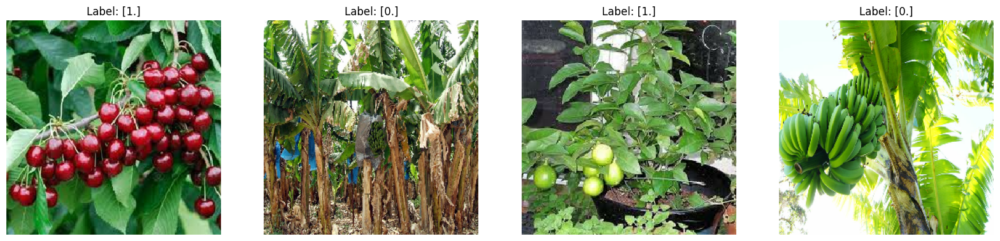

In [115]:
#fig, ax = plt.subplots(ncols=4, figsize=(20,20))
#for idx, img in enumerate(batch[0][:4]):
    #ax[idx].imshow(img.astype(int))
    #ax[idx].title.set_text(batch[1][idx])


import matplotlib.pyplot as plt

# Créer une figure avec 4 sous-graphiques (4 colonnes)
fig, ax = plt.subplots(ncols=4, figsize=(20, 20))

# Boucler sur les 4 premières images du batch
for idx in range(4):
    img = batch[0][idx]  # Extraire l'image
    label = batch[1][idx]  # Extraire le label

    ax[idx].imshow(img.astype("uint8"))  # Afficher l'image
    ax[idx].axis("off")  # Supprimer les axes
    ax[idx].set_title(f"Label: {label}")  # Ajouter le label en titre

plt.show()  # Afficher les images


# 4. Données d'échelle

In [116]:
image_dataset = image_dataset.map(lambda x, y: (x / 255, y))

# data = data.map(lambda x,y: (x/255, y))

In [117]:
# image_dataset.as_numpy_iterator().next()

batch = next(iter(image_dataset.as_numpy_iterator()))
# Accéder à la forme des données de l'image (premier élément du tuple)
print(batch[0].shape)  # Vérifie la forme des données
print(batch[1].shape) # Imprimer la forme des étiquettes

(32, 256, 256, 3)
(32, 1)


# 5. Diviser les données

In [33]:
train_size = int(len(image_dataset)*.7)
val_size = int(len(image_dataset)*.2)
test_size = int(len(image_dataset)*.1)

In [34]:
# Diviser le dataset en entraînement et test
train_size

6

In [35]:
train = image_dataset.take(train_size)
val = image_dataset.skip(train_size).take(val_size)
test = image_dataset.skip(train_size+val_size).take(test_size)

# 6. Créer un modèle d'apprentissage profond

In [36]:
train

<_TakeDataset element_spec=(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 1), dtype=tf.float32, name=None))>

In [40]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, Input, MaxPooling2D, Dense, Flatten, Dropout

In [64]:
model = Sequential([
    Input(shape=(256,256,3)), # Définit la taille d'entrée ici
    Conv2D(16, (3,3), 1, activation='relu'),
    MaxPooling2D(),
    Conv2D(32, (3,3), 1, activation='relu'),
    MaxPooling2D(),
    Conv2D(16, (3,3), 1, activation='relu'),
    MaxPooling2D(),
    Flatten(),
    Dense(256, activation='relu'),
    Dense(1, activation='sigmoid')
])

In [65]:
model.compile('adam', loss=tf.losses.BinaryCrossentropy(), metrics=['accuracy'])

In [66]:
model.summary()

Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_9 (Conv2D)                    │ (None, 254, 254, 16)        │             448 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_9 (MaxPooling2D)       │ (None, 127, 127, 16)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_10 (Conv2D)                   │ (None, 125, 125, 32)        │           4,640 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_10 (MaxPooling2D)      │ (None, 62, 62, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_11 (Conv2D)                   │ (None, 60, 60, 16)          │           4,624 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_11 (MaxPooling2D)      │ (None, 30, 30, 16)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_3 (Flatten)                  │ (None, 14400)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_6 (Dense)                      │ (None, 256)                 │       3,686,656 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_7 (Dense)                      │ (None, 1)                   │             257 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 3,696,625 (14.10 MB)

 Trainable params: 3,696,625 (14.10 MB)

 Non-trainable params: 0 (0.00 B)

# 7. Entraînement

In [67]:
logdir='logs'

In [68]:
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=logdir)

In [69]:
IMG_WIDTH = 256
IMG_HEIGHT = 256
BATCH_SIZE = 32

data_dir = "/content/drive/MyDrive/data/Agricultural-corps"

# Charger les chemins et les étiquettes des images
image_dataset = tf.data.Dataset.list_files(str(data_dir + '/*/*'), shuffle=True)

def get_label(file_path):
    # Convertir le chemin en tensor
    file_path = tf.convert_to_tensor(file_path, dtype=tf.string)
    parts = tf.strings.split(file_path, os.path.sep)
   # Remarque : vous avez supposé que « class1 » et « class2 » sont les seuls sous-répertoires
   # Cela peut nécessiter une mise à jour en fonction des noms réels de vos sous-répertoires dans `data_dir`.
   # Dans un cas plus général, vous devrez mapper les noms des sous-répertoires aux étiquettes numériques.
    one_hot = parts[-2] == "class2"
    # Étiquette entière
    return tf.cast(one_hot, tf.int32)

def decode_img(img):
  # Convertir la chaîne compressée en un tensor 3D uint8
  img = tf.image.decode_jpeg(img, channels=3)
  # Redimensionnez l'image à la taille souhaitée
  return tf.image.resize(img, [256, 256]) #Updated to match model's input shape

def process_path(file_path):
  label = get_label(file_path)
  # Charger les données brutes du fichier sous forme de chaîne
  img = tf.io.read_file(file_path)
  img = decode_img(img)
  return img, label

image_dataset = image_dataset.map(process_path, num_parallel_calls=tf.data.AUTOTUNE)

# Diviser l'ensemble de données en ensembles d'entraînement et de validation
train_size = int(0.8 * len(list(image_dataset)))
train_dataset = image_dataset.take(train_size)
val_dataset = image_dataset.skip(train_size)
test_dataset = val_dataset.skip(val_size) # créer un ensemble de données de test

# Traiter les ensembles de données par lots
train_dataset = train_dataset.batch(BATCH_SIZE)
val_dataset = val_dataset.batch(BATCH_SIZE)
test_dataset = test_dataset.batch(BATCH_SIZE) # ensemble de données de test par lots

# Vérifiez les tailles des ensembles de données train et val
print("Train dataset size:", len(list(train_dataset)))
print("Validation dataset size:", len(list(val_dataset)))
print("Test dataset size:", len(list(test_dataset)))

# Ajuster le modèle
hist = model.fit(train_dataset, epochs=20, validation_data=val_dataset) # Transmettre les ensembles de données par lots

Train dataset size: 8
Validation dataset size: 2
Test dataset size: 2
Epoch 1/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 19s 2s/step - accuracy: 0.4936 - loss: 282.3015 - val_accuracy: 0.3103 - val_loss: 28.4179
Epoch 2/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 17s 2s/step - accuracy: 0.5491 - loss: 12.2496 - val_accuracy: 0.6897 - val_loss: 0.8076
Epoch 3/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 19s 2s/step - accuracy: 0.6019 - loss: 0.7235 - val_accuracy: 0.7069 - val_loss: 0.5830
Epoch 4/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 17s 2s/step - accuracy: 0.6788 - loss: 0.5981 - val_accuracy: 0.7759 - val_loss: 0.5644
Epoch 5/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 17s 2s/step - accuracy: 0.7723 - loss: 0.5313 - val_accuracy: 0.8621 - val_loss: 0.2840
Epoch 6/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 17s 2s/step - accuracy: 0.8345 - loss: 0.3538 - val_accuracy: 0.9828 - val_loss: 0.3022
Epoch 7/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 19s 2s/step - accuracy: 0.9605 - loss: 0.3540 - val_accuracy: 0.9828 - val_loss: 0.2730
Epoch 8/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 17s 2s/step - accuracy

# 8. Performance du Plot

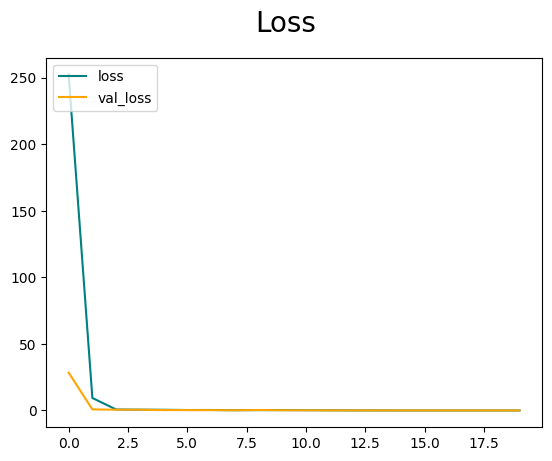

In [70]:
fig = plt.figure()
plt.plot(hist.history['loss'], color='teal', label='loss')
plt.plot(hist.history['val_loss'], color='orange', label='val_loss')
fig.suptitle('Loss', fontsize=20)
plt.legend(loc="upper left")
plt.show()

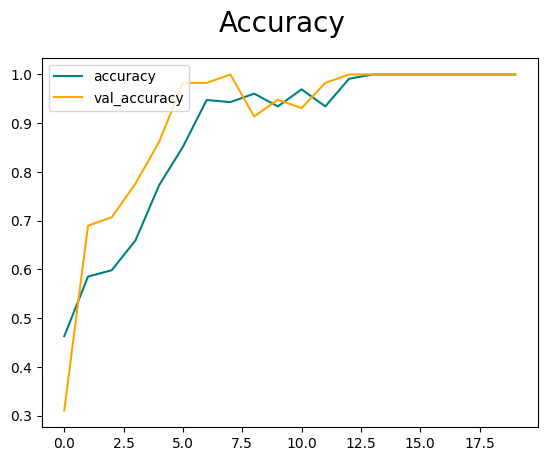

In [71]:
fig = plt.figure()
plt.plot(hist.history['accuracy'], color='teal', label='accuracy')
plt.plot(hist.history['val_accuracy'], color='orange', label='val_accuracy')
fig.suptitle('Accuracy', fontsize=20)
plt.legend(loc="upper left")
plt.show()

# 9. Évaluer

In [72]:
from tensorflow.keras.metrics import Precision, Recall, BinaryAccuracy

In [74]:
pre = Precision()
re = Recall()
acc = BinaryAccuracy()

In [118]:
# Vérifiez si le fichier problématique existe
file_path = '/content/drive/MyDrive/data/Agricultural-corps/class1/tomate (10).jpeg'
if os.path.exists(file_path):
    print(f"fichier '{file_path}' existe.")
else:
    print(f"fichier '{file_path}'n\'existe pas. Veuillez vérifier le chemin du fichier et vous assurer qu\'il est présent dans votre Google Drive.")

fichier '/content/drive/MyDrive/data/Agricultural-corps/class1/tomate (10).jpeg' existe.


In [119]:
for batch in test.as_numpy_iterator():
    X, y = batch
    yhat = model.predict(X)
    pre.update_state(y, yhat)
    re.update_state(y, yhat)
    acc.update_state(y, yhat)

In [120]:
print(pre.result(), re.result(), acc.result())

tf.Tensor(0.0, shape=(), dtype=float32) tf.Tensor(0.0, shape=(), dtype=float32) tf.Tensor(0.0, shape=(), dtype=float32)


# 10. Test

In [121]:
import cv2

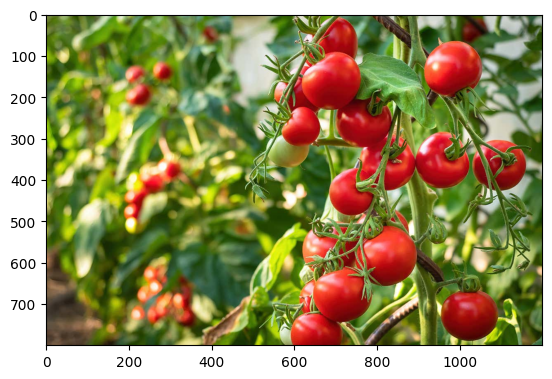

In [122]:
# Lire l'image avec OpenCV
img = cv2.imread('/content/drive/MyDrive/data/Agricultural-corps/tomate (2).jpg')

# Convertir BGR en RGB
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# Afficher l'image avec Matplotlib
plt.imshow(img)
# plt.axis('off')  # Masquer les axes
plt.show()

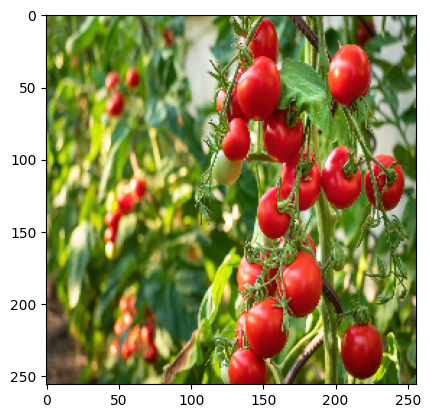

In [123]:
# Convertir l'image en tenseur float32
img_tensor = tf.convert_to_tensor(img, dtype=tf.float32)

# Redimensionner l'image
resize = tf.image.resize(img_tensor, (256, 256))

# Afficher l'image redimensionnée
plt.imshow(resize.numpy().astype("uint8"))  # Convertir en uint8 pour affichage correct
# plt.axis('off')  # Masquer les axes
plt.show()

In [126]:
yhat = model.predict(np.expand_dims(resize/255, 0))

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


In [127]:
yhat

array([[0.50107]], dtype=float32)

In [128]:
if yhat > 0.5:
    print(f'La classe prédite est la classe 1')
else:
    print(f'La classe prédite est la classe 2')

La classe prédite est la classe 1


# 11. Sauvegarder le modèle

In [129]:
from tensorflow.keras.models import load_model

In [130]:
# Enregistrer le modèle dans le nouveau format Keras
model.save('my_model.keras')

In [131]:
# Recharger le moddel
model = tf.keras.models.load_model('/content/my_model.keras', compile=False)

# Vérifier l'architecture
model.summary()

Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_9 (Conv2D)                    │ (None, 254, 254, 16)        │             448 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_9 (MaxPooling2D)       │ (None, 127, 127, 16)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_10 (Conv2D)                   │ (None, 125, 125, 32)        │           4,640 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_10 (MaxPooling2D)      │ (None, 62, 62, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_11 (Conv2D)                   │ (None, 60, 60, 16)          │           4,624 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_11 (MaxPooling2D)      │ (None, 30, 30, 16)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_3 (Flatten)                  │ (None, 14400)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_6 (Dense)                      │ (None, 256)                 │       3,686,656 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_7 (Dense)                      │ (None, 1)                   │             257 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 3,696,625 (14.10 MB)

 Trainable params: 3,696,625 (14.10 MB)

 Non-trainable params: 0 (0.00 B)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


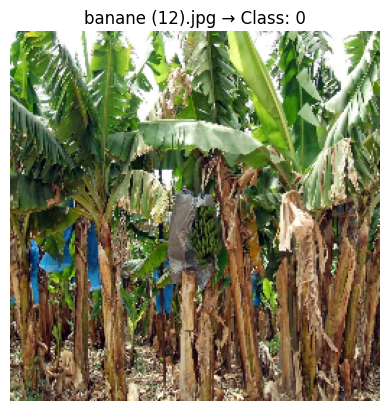

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


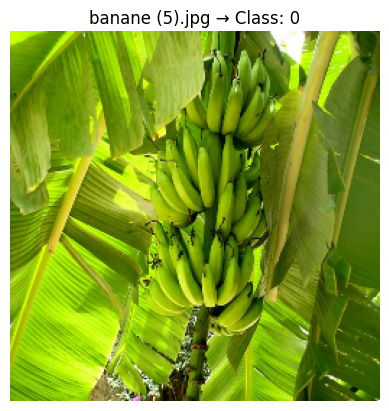

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step


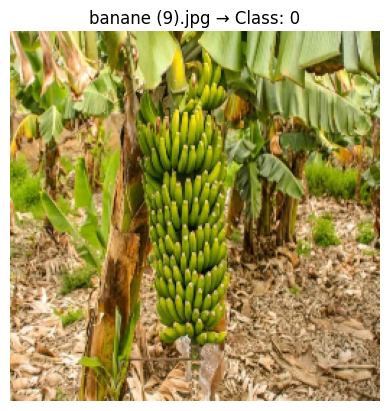

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


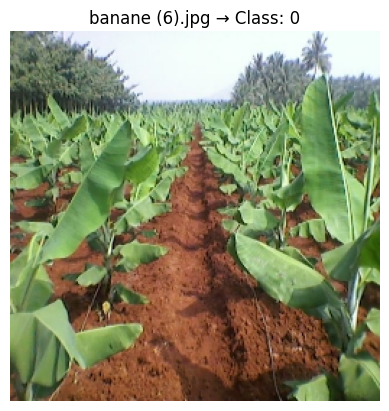

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


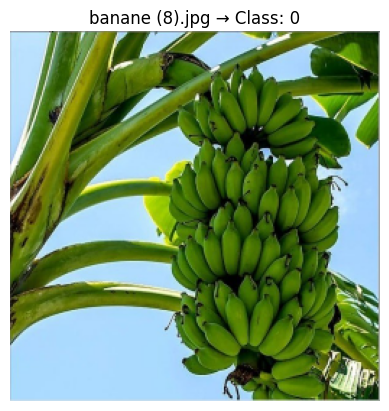

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


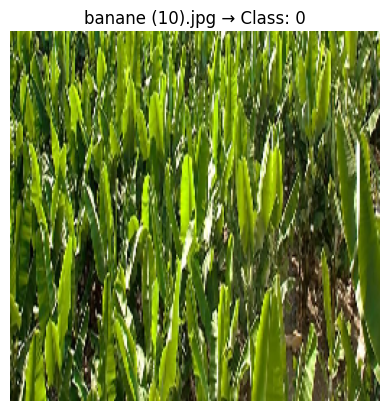

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


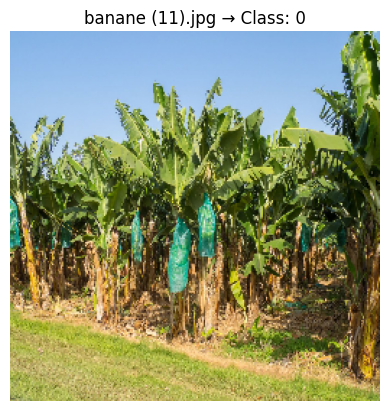

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


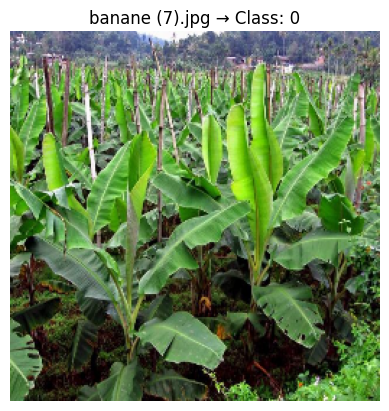

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


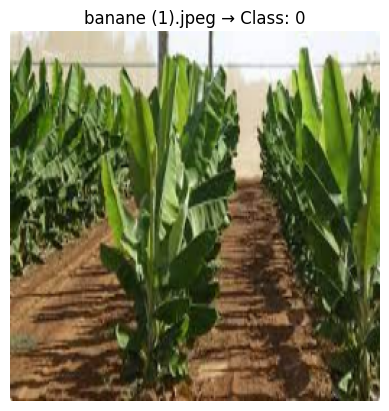

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


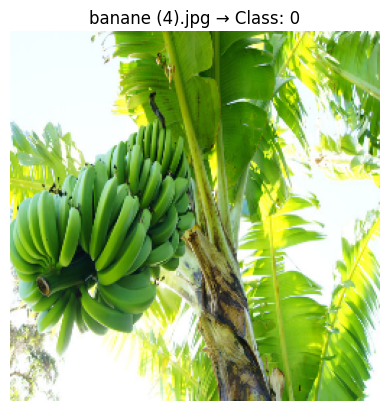

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


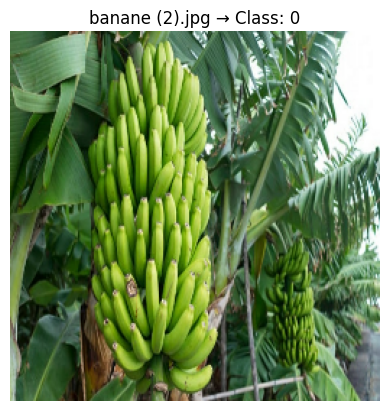

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


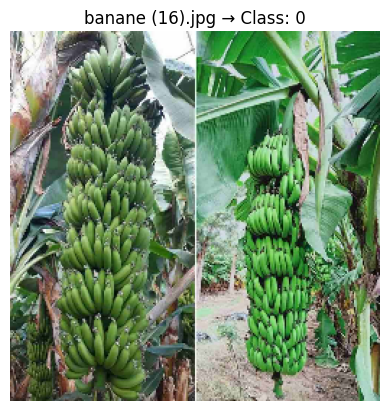

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


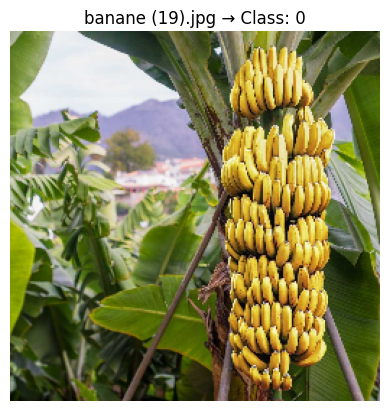

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


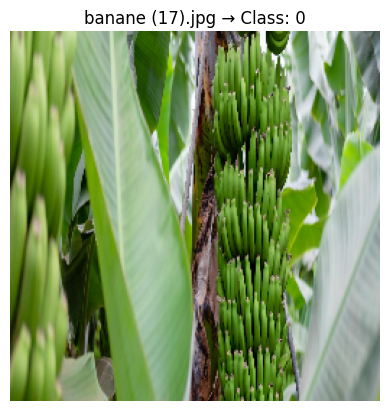

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


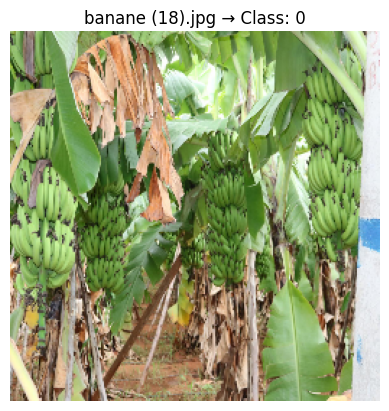

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


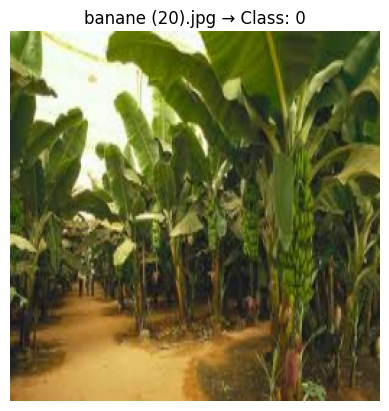

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


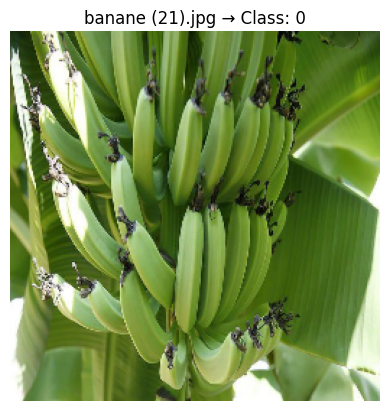

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


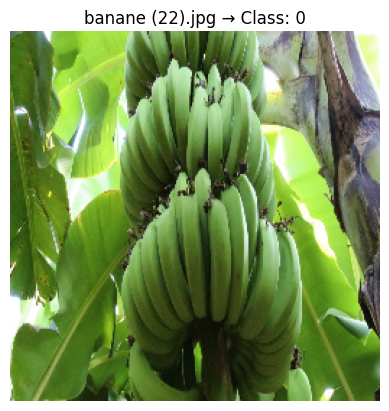

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


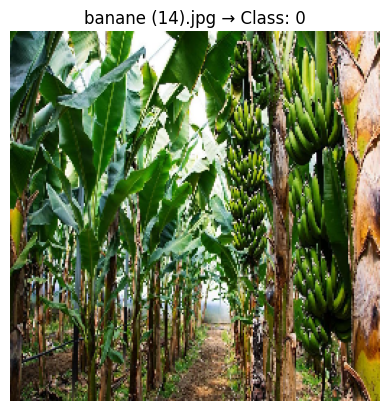

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


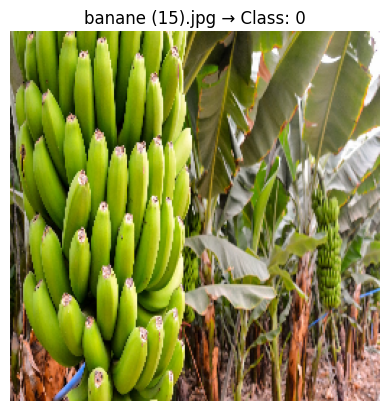

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


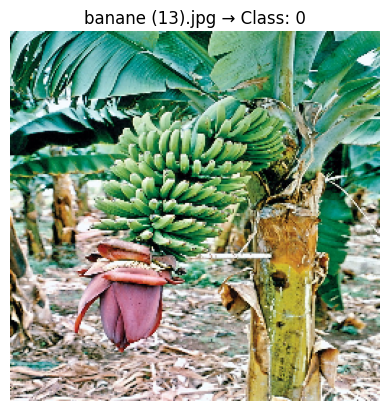

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


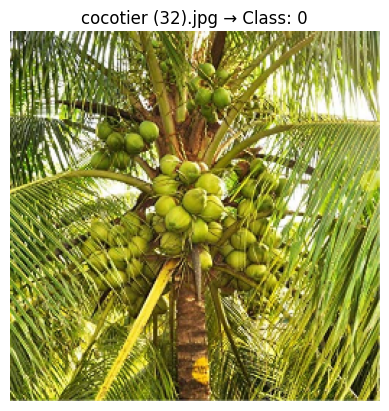

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


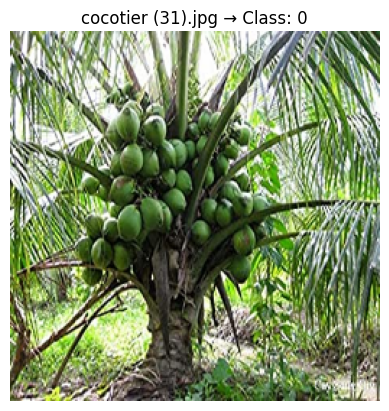

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


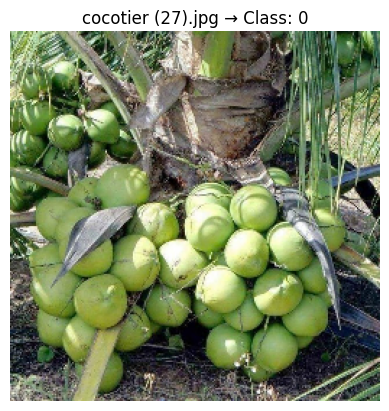

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


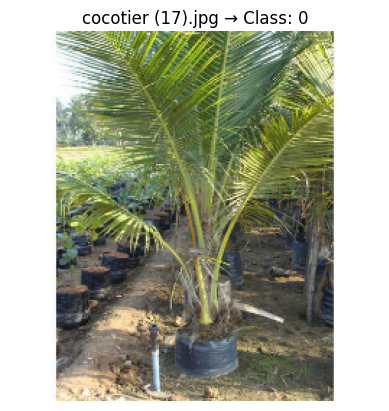

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


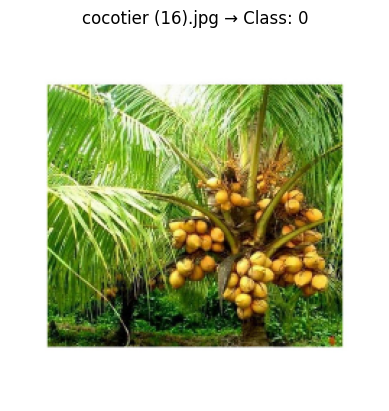

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


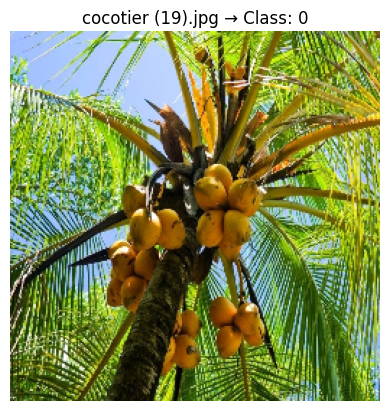

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


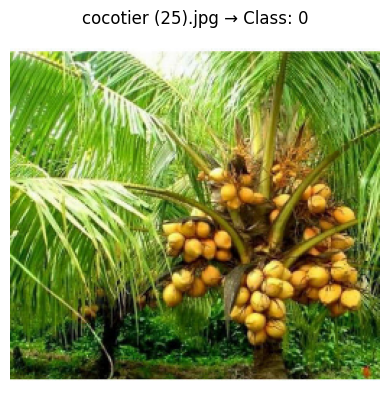

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


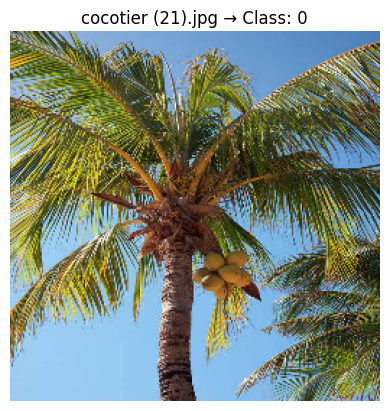

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


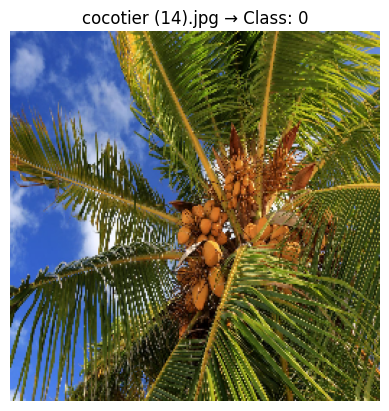

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


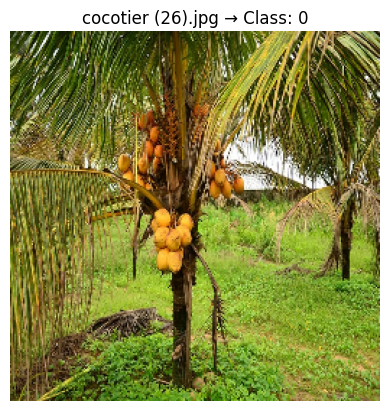

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


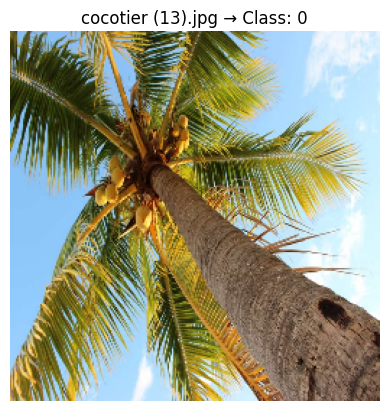

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


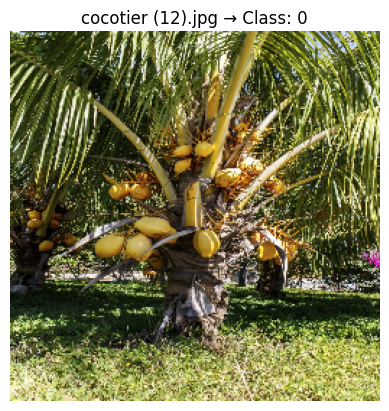

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


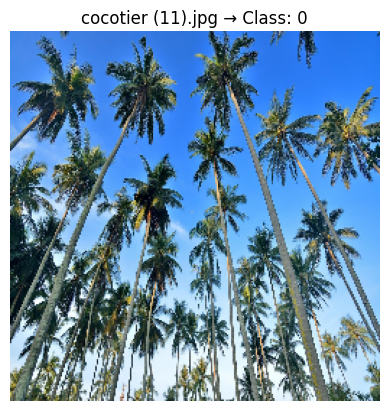

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


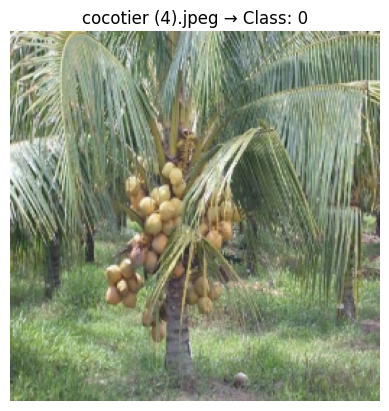

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


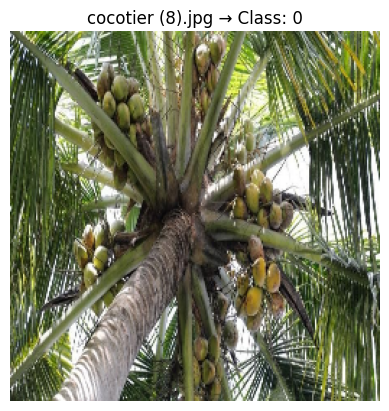

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


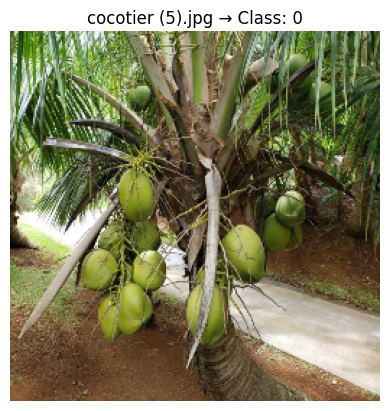

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


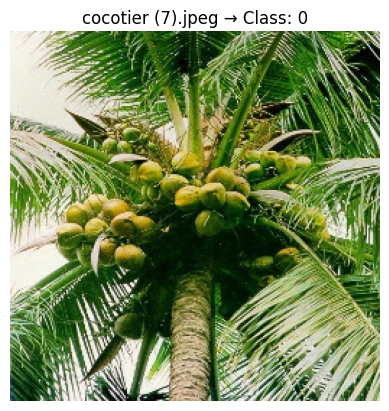

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


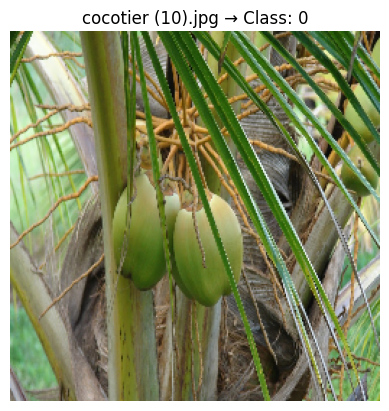

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


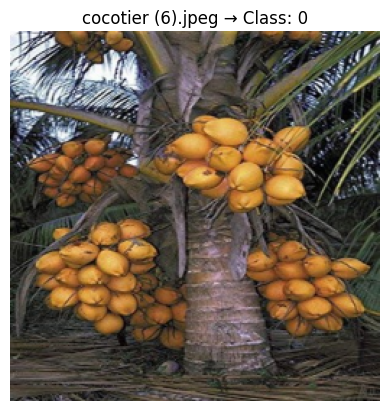

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


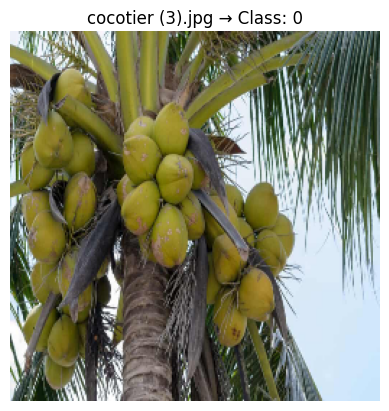

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


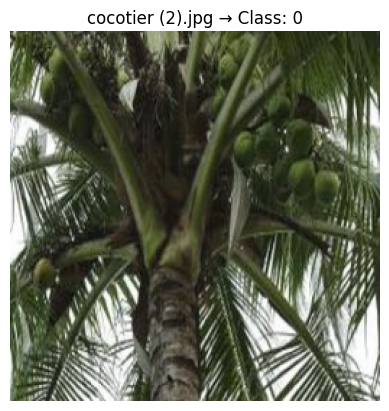

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


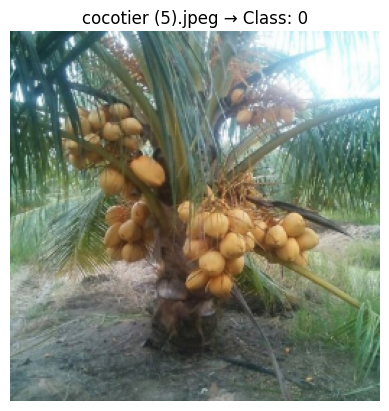

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


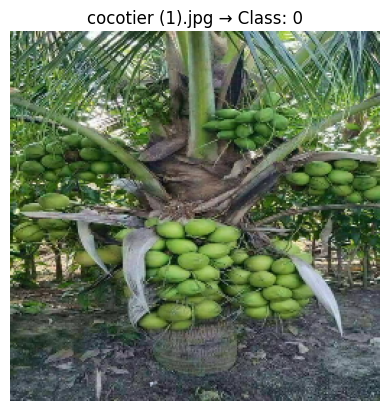

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


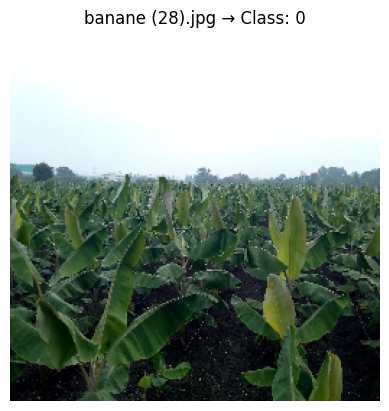

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


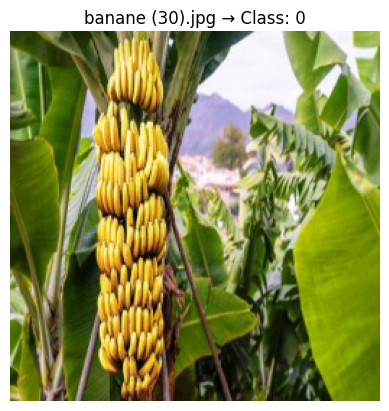

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


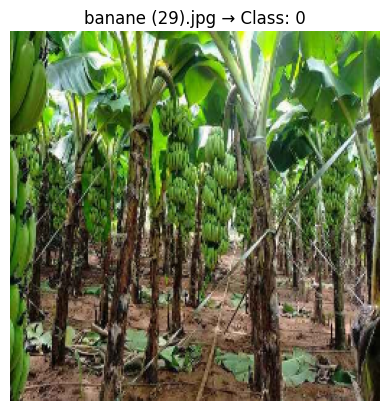

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


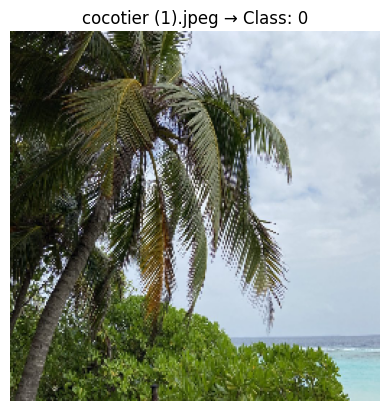

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


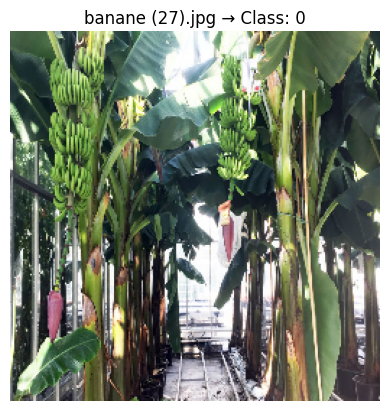

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


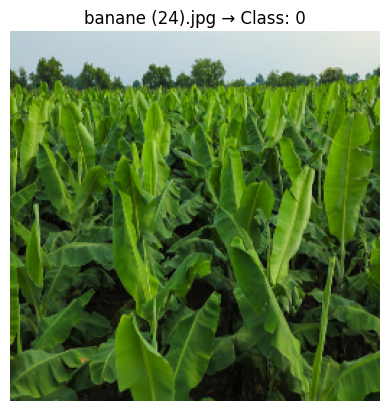

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


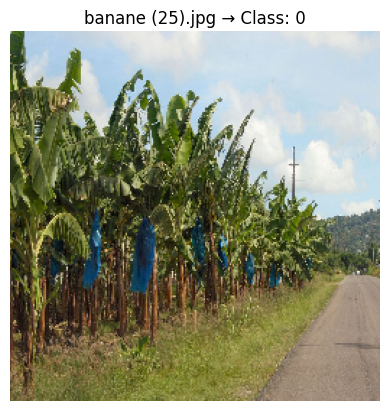

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


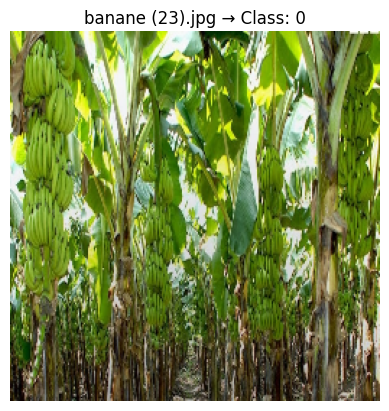

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


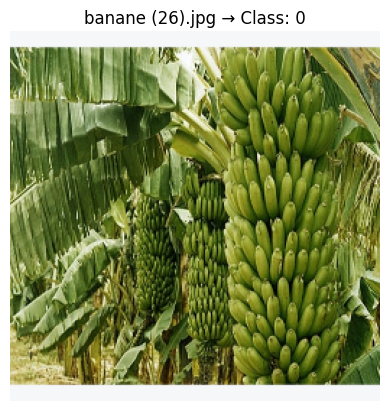

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


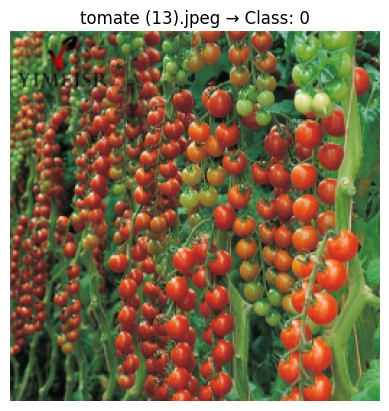

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


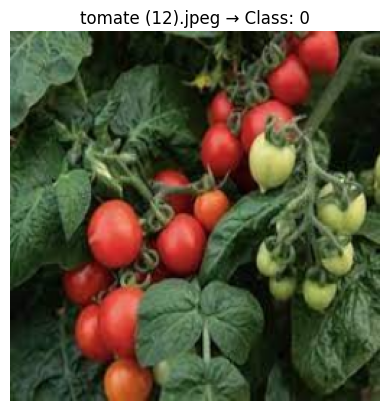

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


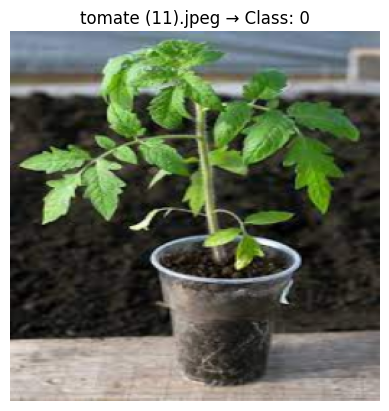

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


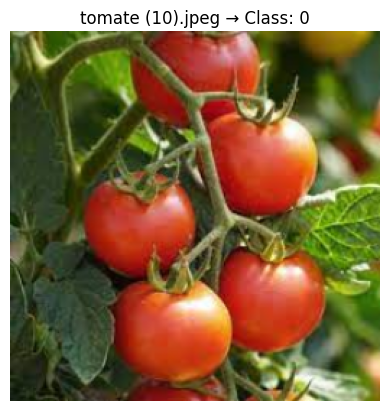

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


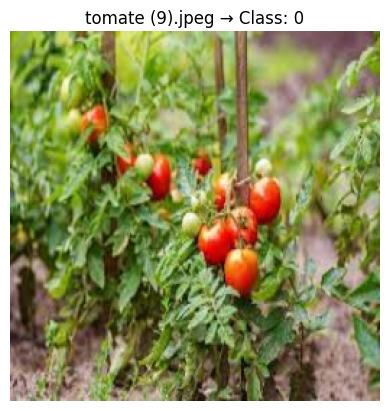

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


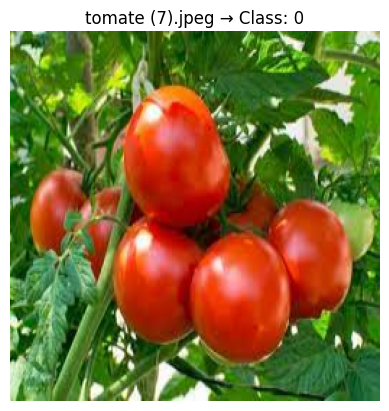

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


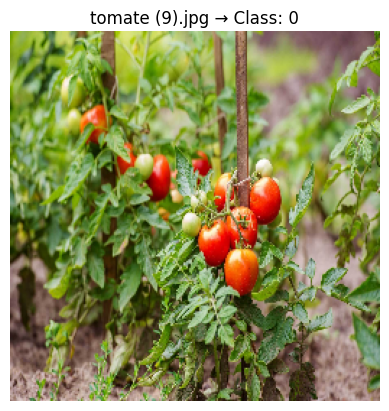

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


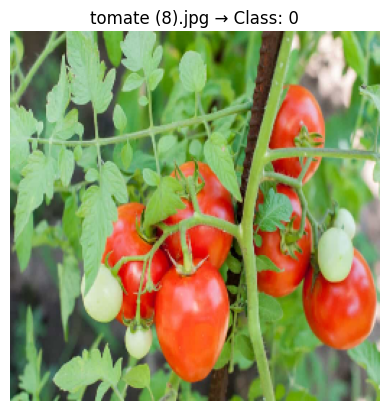

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


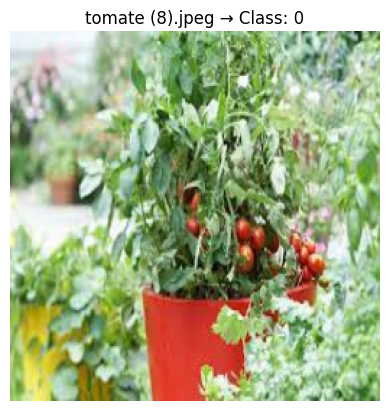

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


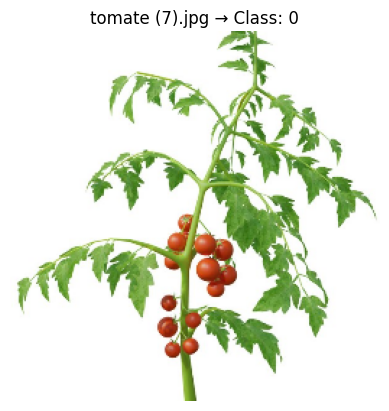

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


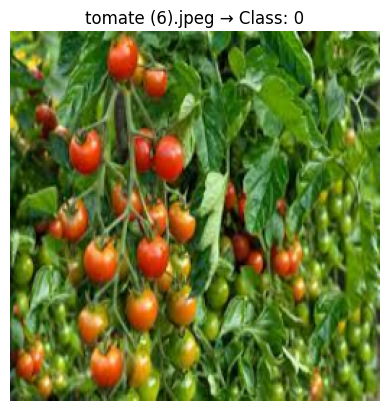

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


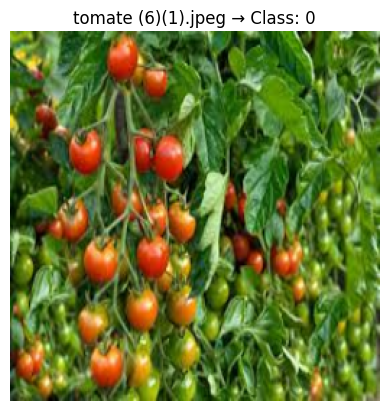

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


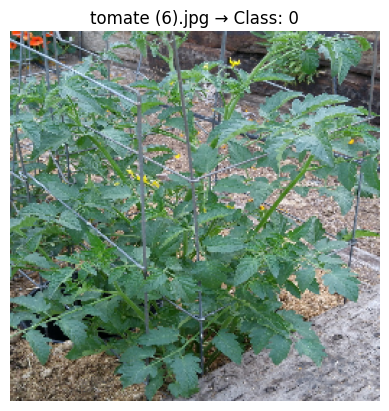

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


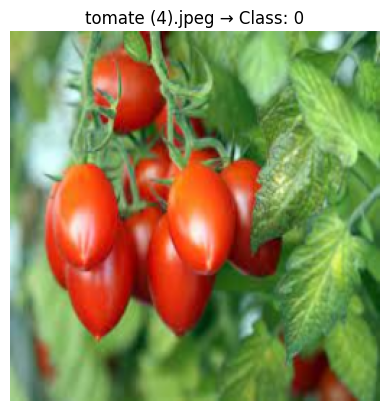

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


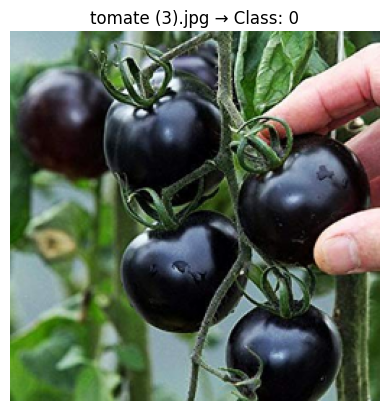

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


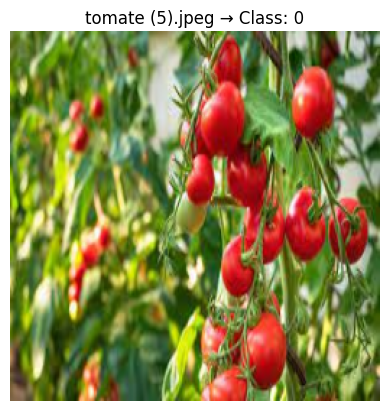

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


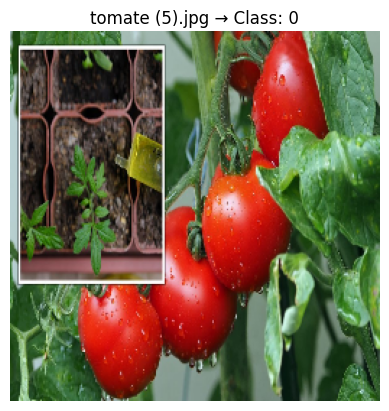

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


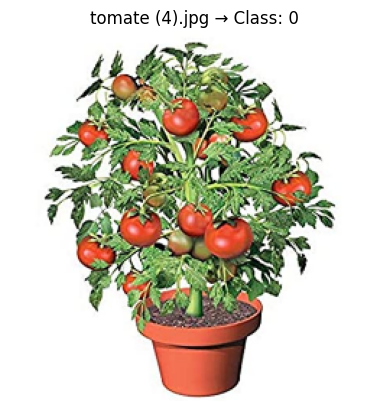

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


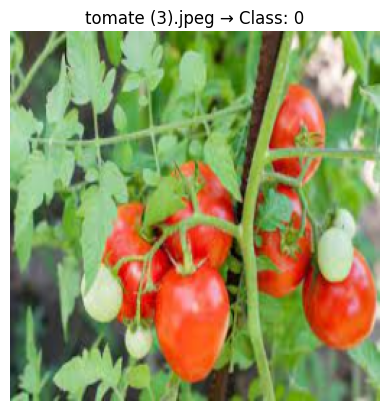

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


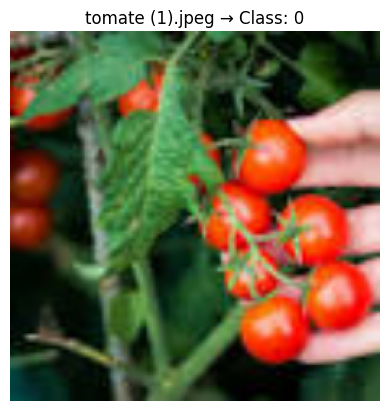

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


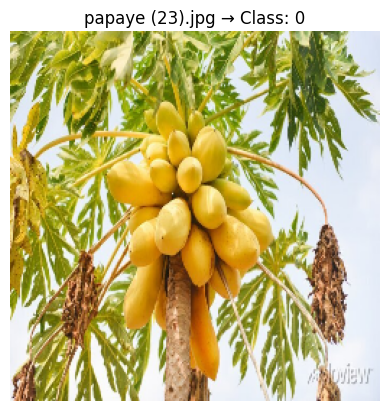

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


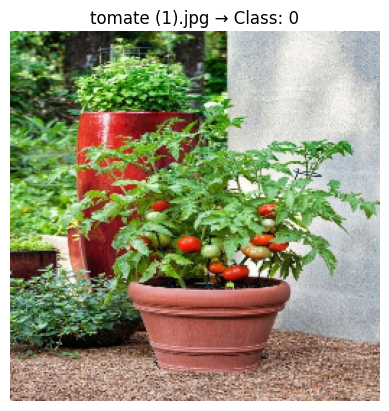

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


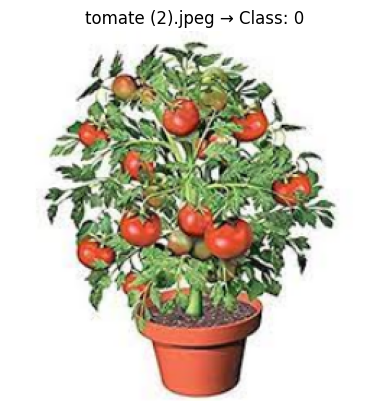

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


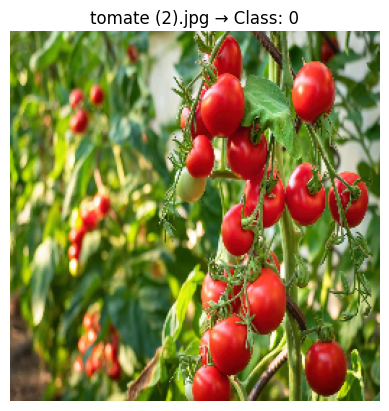

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


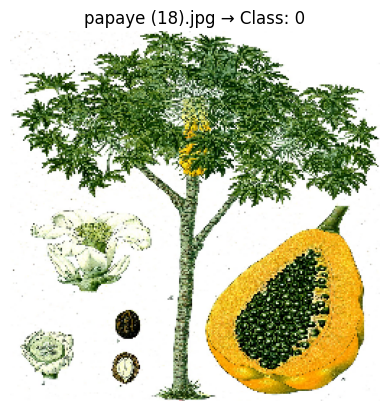

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


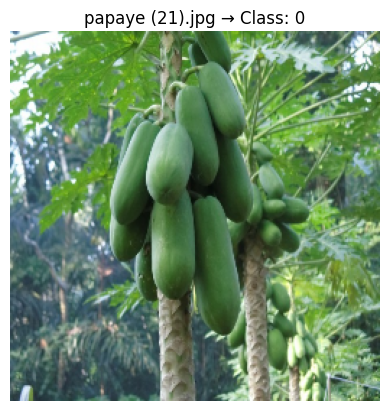

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


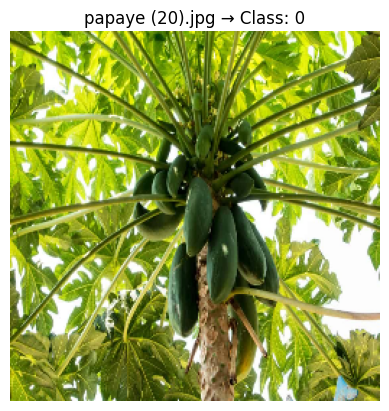

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


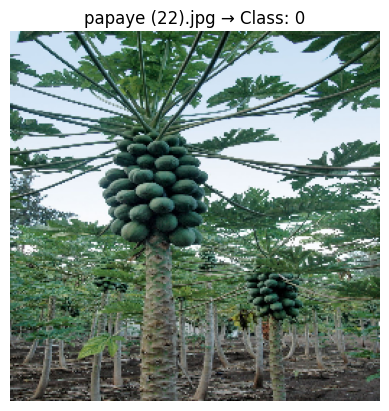

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


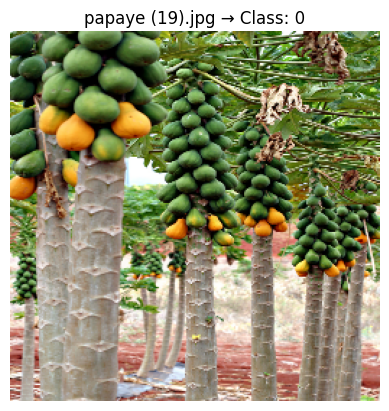

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


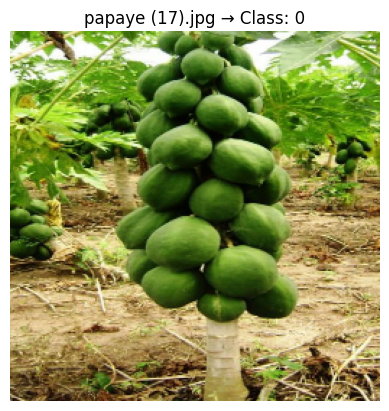

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


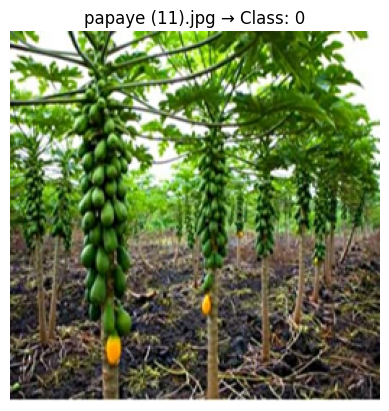

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


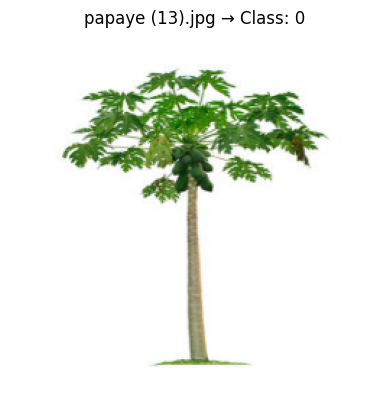

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


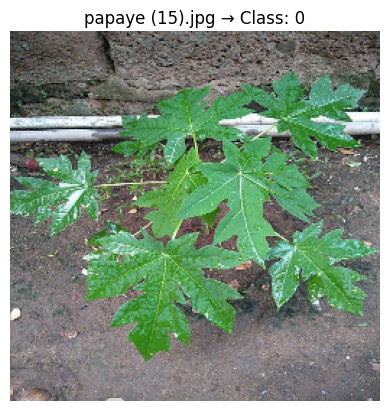

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


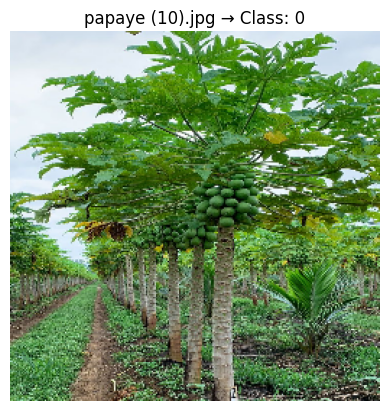

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


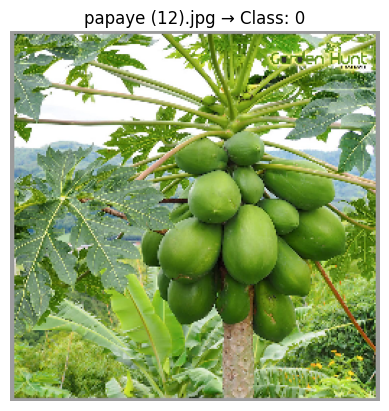

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


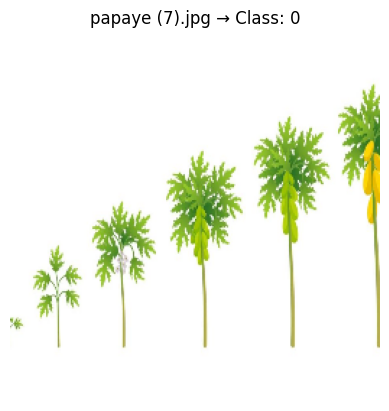

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


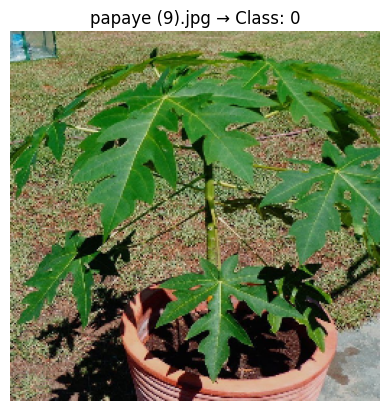

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


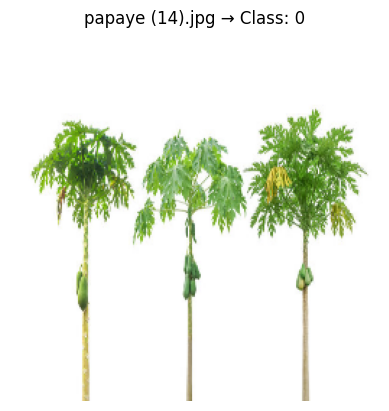

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


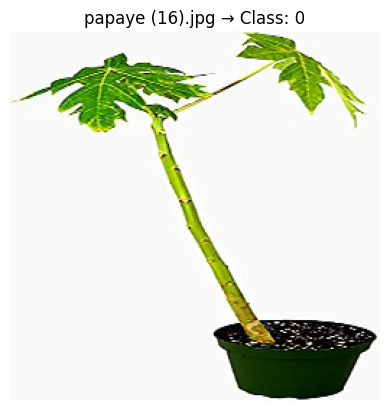

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


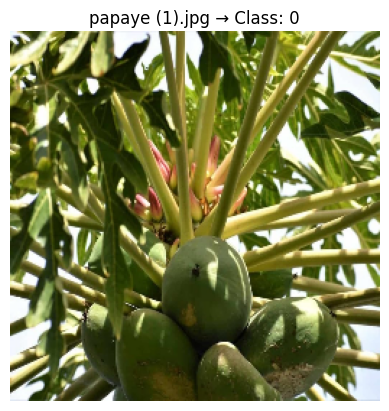

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


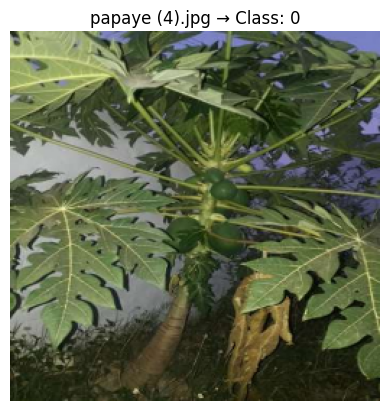

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


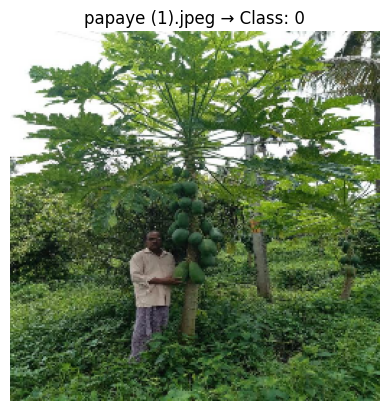

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


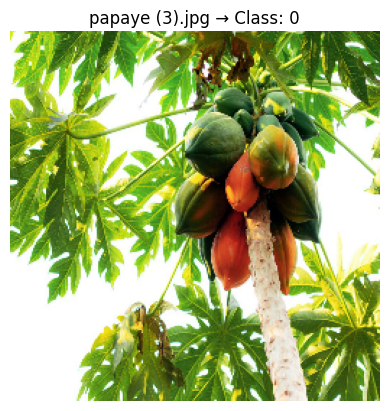

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


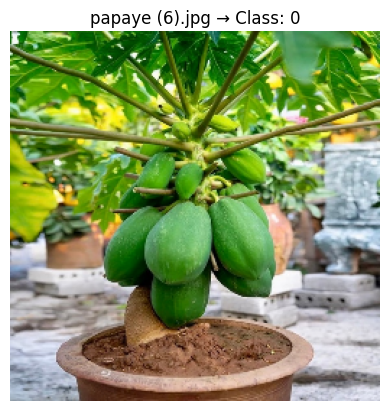

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


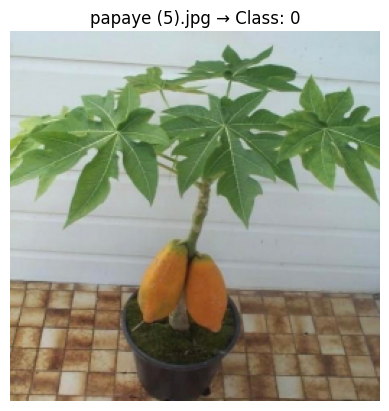

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


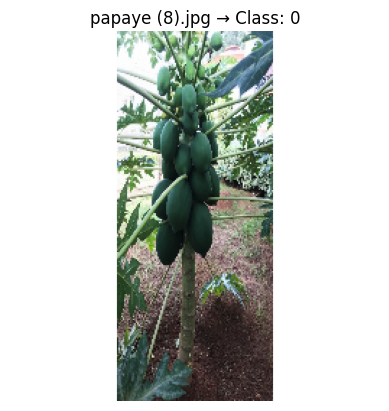

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


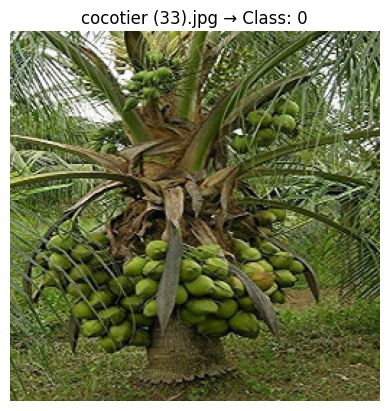

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


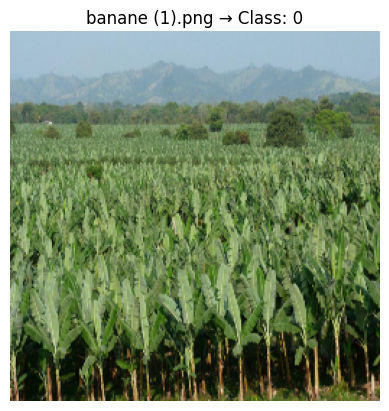

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


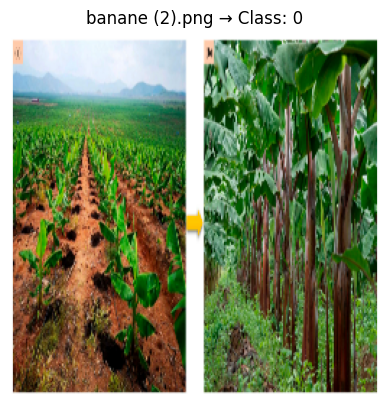

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


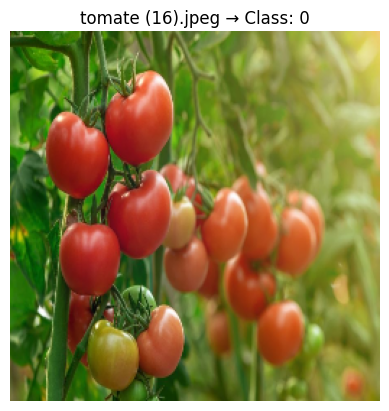

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


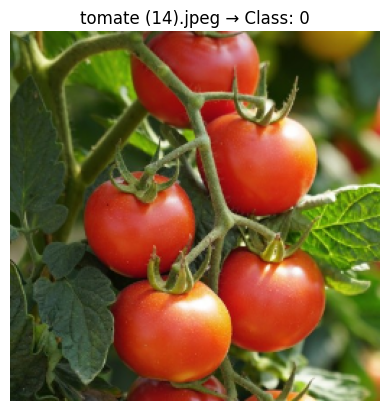

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


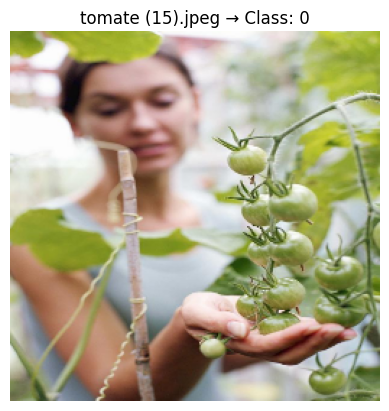

In [107]:
# Chemin du dossier contenant les images
image_folder = '/content/drive/MyDrive/data/Agricultural-corps/class1'

# Parcourir les images du dossier
for filename in os.listdir(image_folder):
    if filename.endswith(('.jpg', '.png', '.jpeg')):  # Vérifier qu'il s'agit d'une image
        image_path = os.path.join(image_folder, filename)
        img = cv2.imread(image_path)

        if img is not None:  # Vérifier si l'image a bien été chargée
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convertir BGR → RGB
            img_resized = tf.image.resize(img, (256, 256))  # Redimensionner

            # Normaliser l'image (entre 0 et 1)
            img_normalized = img_resized / 255.0

            # Ajouter une dimension batch (pour la prédiction)
            img_input = np.expand_dims(img_normalized.numpy(), axis=0).astype(np.float32)

            # Faire la prédiction
            predictions = model.predict(img_input)

            # Classe prédite (si softmax en sortie)
            predicted_class = np.argmax(predictions)

            # Afficher l'image et la classe prédite
            plt.imshow(img_resized.numpy().astype("uint8"))
            plt.axis('off')
            plt.title(f"{filename} → Class: {predicted_class}")
            plt.show()
        else:
            print(f"⚠️ Impossible de charger l'image : {image_path}")

In [110]:
model.predict(np.expand_dims(resize/256, 0))

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step


array([[0.43898752]], dtype=float32)